# Imports

In [ ]:
import warnings
warnings.filterwarnings('ignore')
import librosa
import pandas as pd
import IPython.display as ipd

In [ ]:
#New libraries
%matplotlib inline
import sklearn
from sklearn import preprocessing
import matplotlib.pyplot as plt
import librosa.display
import numpy as np
import soundfile as sf

# Loading Audio File

In [ ]:
#Load the audio file
audio_path = '/content/Music Folder/Paramore - Misery Business (HQ Audio).wav'
x,sr = librosa.load(audio_path)

# Playing Audio File

In [ ]:
#Play the audio file
ipd.Audio(audio_path)

# Visualizing Audio - Waveform

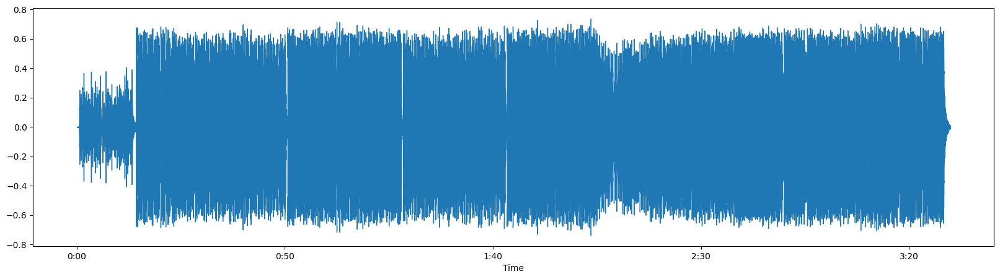

In [ ]:
#Waveform
plt.figure(figsize=(20,5))
librosa.display.waveshow(x,sr=sr)

# Visualizing Audio - Spectogram

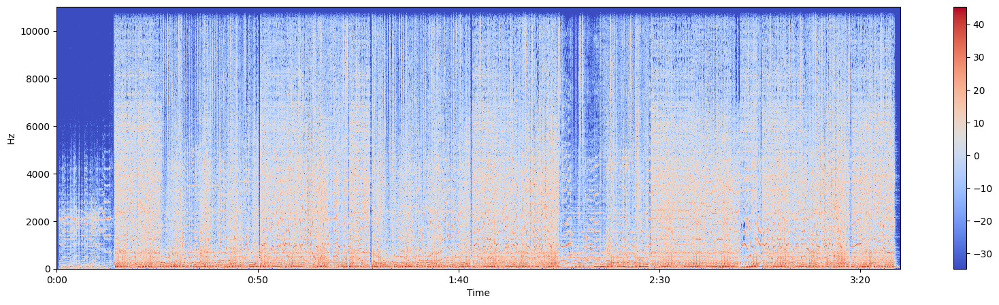

In [ ]:
#Spectogram
X = librosa.stft(x)
Xdb = librosa.amplitude_to_db(abs(X))
plt.figure(figsize=(20,5))
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='hz')
plt.colorbar()

# Visualizing Audio - Log Frequency

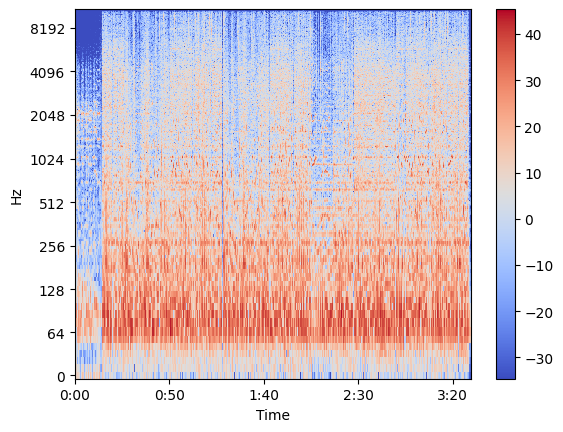

In [ ]:
#Log Frequency Axis
librosa.display.specshow(Xdb, sr=sr, x_axis='time', y_axis='log')
plt.colorbar()

# Creating an audio signal

In [ ]:
sr = 22050 #sampling rate
T = 5.0 #seconds
t = np.linspace(0, T, int(T*sr), endpoint=False) #time variable
x = 0.5*np.sin(2*np.pi*220*t) #pure sine wave at 220 hz

# Playing the sound

In [ ]:
ipd.Audio(x, rate=sr) # load a NumPy array

# Saving the signal

In [ ]:
sf.write('/content/Music Folder/tone_440.wav', x, sr) # writing wave file in tone440.wav format

# Feature Extraction

In [ ]:
x, sr = librosa.load('/content/Music Folder/Paramore - Misery Business (HQ Audio).wav')
ipd.Audio(x, rate=sr)

# Plotting the signal

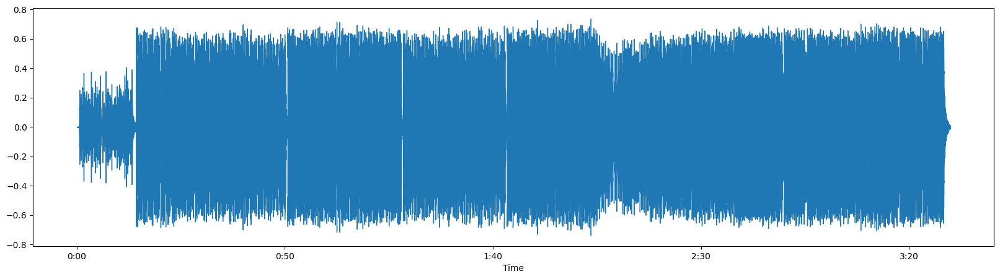

In [ ]:
#Plot the signal:
plt.figure(figsize=(20, 5))
librosa.display.waveshow(x, sr=sr)

# 1. Zero Crossing Rate

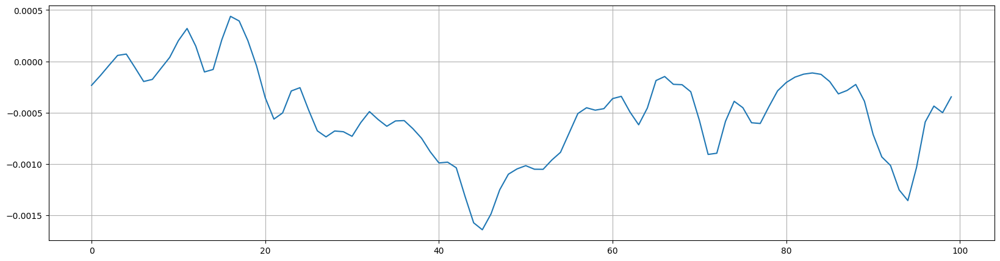

In [ ]:
# Zooming in
n0 = 9000
n1 = 9100
plt.figure(figsize=(20, 5))
plt.plot(x[n0:n1])
plt.grid()

In [ ]:
zero_crossings = librosa.zero_crossings(x[n0:n1], pad=False)
zero_crossings.shape

(100,)

In [ ]:
print(sum(zero_crossings))

6


# 2.Spectral Centroid

In [ ]:
#Spectral centroid measures the average frequency of a spectrum
spectral_centroids = librosa.feature.spectral_centroid(y=x, sr=sr)[0]
spectral_centroids.shape

(9042,)

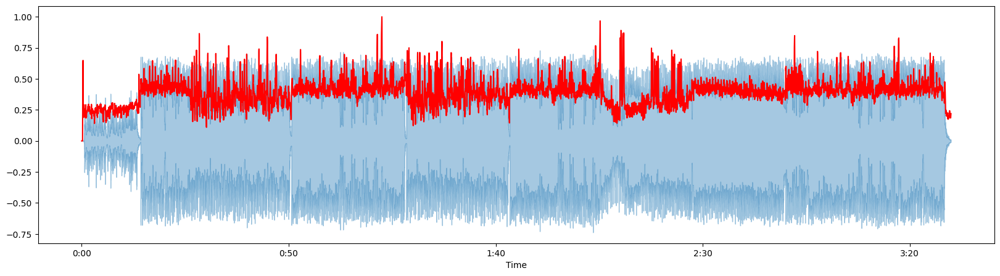

In [ ]:
# Computing the time variable for visualization
plt.figure(figsize=(20,5))
frames = range(len(spectral_centroids))
t = librosa.frames_to_time(frames)

# Normalising the spectral centroid for visualisation
def normalize(x, axis=0):
    return sklearn.preprocessing.minmax_scale(x, axis=axis)

#Plotting the Spectral Centroid along the waveform
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_centroids), color='r')

# 3.Spectral Rolloff

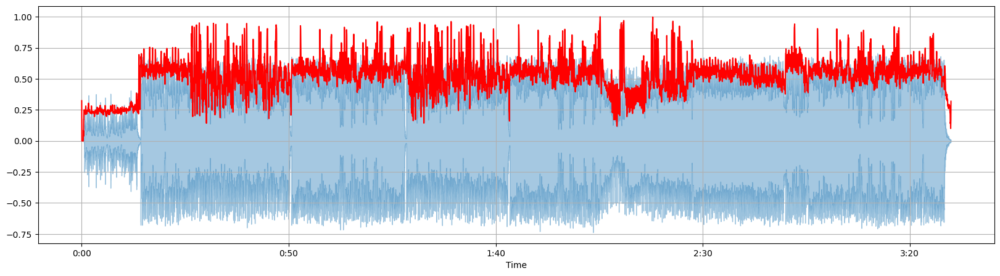

In [ ]:
plt.figure(figsize=(20,5))
spectral_rolloff = librosa.feature.spectral_rolloff(y=x+0.01, sr=sr)[0]
librosa.display.waveshow(x, sr=sr, alpha=0.4)
plt.plot(t, normalize(spectral_rolloff), color='r')
plt.grid()

# 4.MFCC

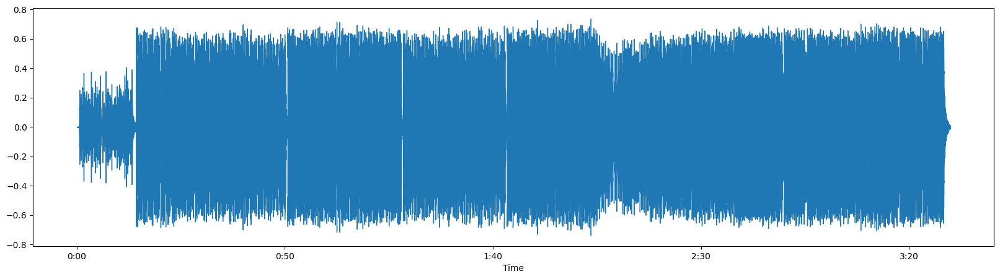

In [ ]:
plt.figure(figsize=(20,5))
x, fs = librosa.load('/content/Music Folder/Paramore - Misery Business (HQ Audio).wav')
librosa.display.waveshow(x, sr=sr)

(20, 9042)


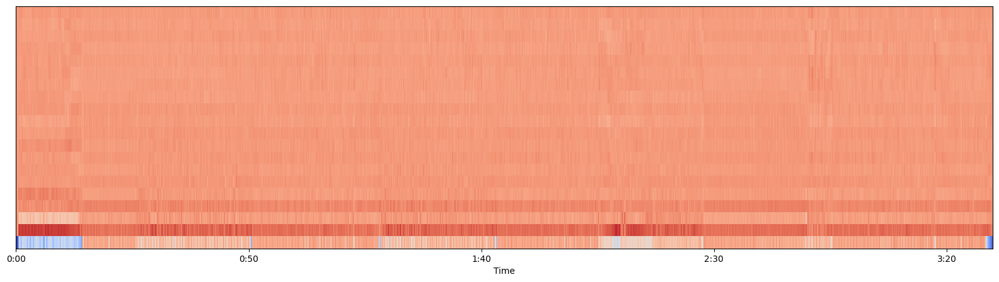

In [ ]:
# MFCC
plt.figure(figsize=(20,5))
mfccs = librosa.feature.mfcc(y=x, sr=sr)
print(mfccs.shape)

librosa.display.specshow(mfccs, sr=sr, x_axis='time')

# 5 Feature Scaling



In [ ]:
mfccs = sklearn.preprocessing.scale(mfccs, axis=1)
print(mfccs.mean(axis=1))
print(mfccs.var(axis=1))

[-5.0626374e-09  1.3500366e-08 -4.2188644e-10  5.9064105e-09
  0.0000000e+00 -3.3750915e-09  8.4377287e-09  2.5313187e-09
 -6.7501831e-09  8.0158422e-09  6.7501831e-09 -5.0626374e-09
 -8.4377287e-09  0.0000000e+00  2.5313187e-09  5.0626374e-09
  1.6875458e-09  8.4377287e-09 -5.4845239e-09  7.5939557e-09]
[1.        1.0000001 0.9999999 1.        1.        1.        1.0000001
 0.9999999 1.        1.        1.        1.        1.        1.0000001
 1.        1.        1.0000001 1.        1.        1.0000001]


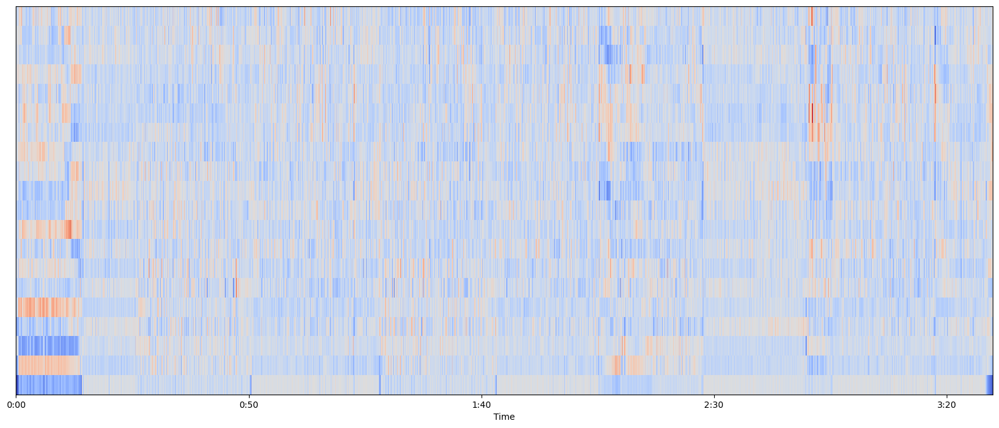

In [ ]:
plt.figure(figsize=(20,8))
librosa.display.specshow(mfccs, sr=sr, x_axis='time')

# 6 Chroma Frequencies

In [ ]:
# Loading the file
x, sr = librosa.load('/content/Music Folder/Paramore - Misery Business (HQ Audio).wav')
ipd.Audio(x, rate=sr)

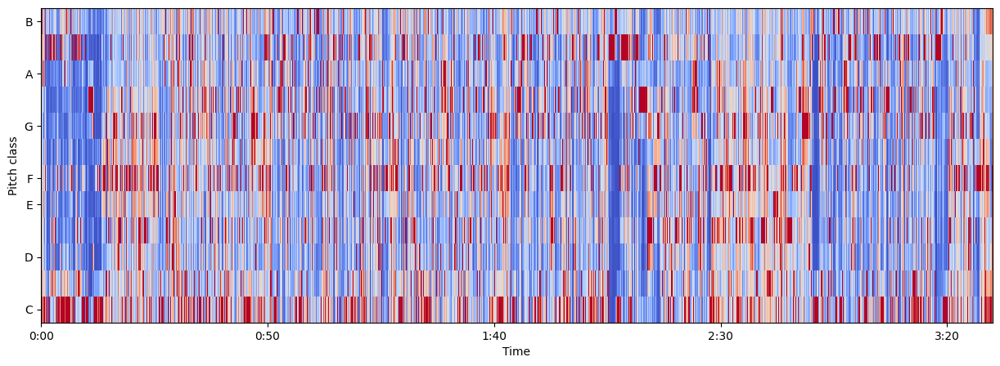

In [ ]:
hop_length = 512
chromagram = librosa.feature.chroma_stft(y=x, sr=sr, hop_length=hop_length)
plt.figure(figsize=(15, 5))
librosa.display.specshow(chromagram, x_axis='time', y_axis='chroma', hop_length=hop_length, cmap='coolwarm')

# Save the extracted features, and the correspoding genre label

In [ ]:
genre_label = 'Rock'

# Extract MFCC features
mfccs = librosa.feature.mfcc(y=x, sr=sr)

# Calculate zero crossing rate
zero_crossings = librosa.feature.zero_crossing_rate(x)

# Calculate spectral centroid
spectral_centroids = librosa.feature.spectral_centroid(y=x, sr=sr)

# Calculate spectral rolloff
spectral_rolloff = librosa.feature.spectral_rolloff(y=x, sr=sr)

# Calculate chroma frequencies
chroma = librosa.feature.chroma_stft(y=x, sr=sr)

# Scale the MFCC features
mfccs_scaled = sklearn.preprocessing.scale(mfccs, axis=1)

# Calculate the mean and variance of scaled MFCC features
mfccs_mean = np.mean(mfccs_scaled, axis=0)
mfccs_var = np.var(mfccs_scaled, axis=0)

# Create a DataFrame for the features
df = pd.DataFrame()

# Add MFCC features
for i in range(mfccs_scaled.shape[0]):
    df[f'MFCC{i+1}'] = mfccs_scaled[i]

# Add zero crossing rate
df['Zero Crossing Rate'] = zero_crossings[0]

# Add spectral centroid
df['Spectral Centroid'] = spectral_centroids[0]

# Add spectral rolloff
df['Spectral Rolloff'] = spectral_rolloff[0]

# Add chroma frequencies
for i in range(chroma.shape[0]):
    df[f'Chroma{i+1}'] = chroma[i]

# Add mean and variance of MFCC features
df['MFCC Mean'] = mfccs_mean
df['MFCC Variance'] = mfccs_var

# Add the genre label column
df['Genre'] = genre_label

# Save the DataFrame to a CSV file
df.to_csv('rock-music-extracted_features.csv', index=False)